<p><font size="6"><b> CASE - CurieuzeNeuzen citizen science air quality data</b></font></p>


> *DS Python for GIS and Geoscience*  
> *September, 2023*
>
> *© 2023, Joris Van den Bossche and Stijn Van Hoey. Licensed under [CC BY 4.0 Creative Commons](http://creativecommons.org/licenses/by/4.0/)*

---

Air pollution remains a key environmental problem in an increasingly urbanized world. While concentrations of traffic-related pollutants like nitrogen dioxide (NO2) are known to vary over short distances, official monitoring networks remain inherently sparse, as reference stations are costly to construct and operate.

The [**CurieuzeNeuzen**](https://curieuzeneuzen.be/curieuzeneuzen-vlaanderen-2018/) citizen science project collected a large, spatially distributed dataset that can complement official monitoring. In a first edition in 2016, in Antwerp, 2000 citizens were involved. This success was followed by a second edition in 2018 engaging 20.000 citizens across Flanders, a highly urbanized, industrialized and densely populated region in Europe. The participants measured the NO2 concentrations in front of their house using a low-cost sampler design (see picture below, where passive sampling tubes are attached using a panel to a window at the facade). 

Source: preprint paper at https://eartharxiv.org/repository/view/19/

In this case study, we are going to make use of the data collected across Flanders in 2018: explore the data and investigate relationships with other variables.

<img src="../img/CN_measurement_setup.png" alt="Measurement panel" style="width:800px">

In [1]:
import numpy as np
import pandas as pd
import geopandas

import matplotlib.pyplot as plt

## Importing and exploring the data

<div class="alert alert-success">

**EXERCISE 1**:

* Read the csv file from `data/CN_Flanders_open_dataset.csv` into a DataFrame `df` and inspect the data.
* How many measurements do we have?

</div>

In [2]:
df = geopandas.read_file("data/CN_Flanders_open_dataset.csv")

df

,code,campaign,no2,lat,lon,geometry
0,1387656,facade,23.0,50.82594,4.704003,None
1,192852,facade,47.3,51.21328,4.4447019999999995,None
2,192873,facade,21.2,51.30897,4.188672,None
3,192876,facade,26.6,51.0962,3.991424,None
4,192879,facade,25.6,51.199220000000004,4.461859,None
...,...,...,...,...,...,...
17881,STAT_R811,reference station,18.7,51.25159,4.491521,None
17882,STAT_R817,reference station,24.8,51.177409999999995,4.417936,None
17883,STAT_R831,reference station,23.8,51.34881,4.339557,None
17884,STAT_R833,reference station,22.0,51.32855,4.36396,None


In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality1.py
df = pd.read_csv("./data/CN_Flanders_open_dataset.csv")
df

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality2.py
len(df)

The dataset contains longitude/latitude columns of the measurement locations, the measured NO2 concentration, and in addition also a "campaign" column indicating the type of measurement location (and an internal "code", which we will ignore here).

<div class="alert alert-success">

**EXERCISE 2**:

* Check the unique values of the "campaign" columns and how many occurrences those have.

    
<details><summary>Hints</summary>

* A pandas Series has a `value_counts()` method that counts the unique values of the column.

</details>

</div>

In [3]:
df['campaign'].value_counts()

campaign
facade               17842
background              23
reference station       21
Name: count, dtype: int64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality3.py

Most of the measurements are performed at the facade of the house or building of a participant. In addition, some measurement tubes were also placed next to reference monitoring stations of the VMM and in background locations (e.g. nature reserve or park).

Let's now explore the measured NO2 concentrations.

<div class="alert alert-success">

**EXERCISE 3**:

* Calculate the overall average NO2 concentration of all locations (i.e. the mean of the "no2" column). 
* Calculate a combination of descriptive statistics of the NO2 concentration using the `describe()` method.
* Make a histogram of the NO2 concentrations to get a visual idea of the distribution of the concentrations.
    
<details><summary>Hints</summary>

* To calculate the mean of a column, we first need to select it: using the square bracket notation `df[colname]`
* The average can be calculate with the `mean()` method
* A histogram of a column can be plotted with the `hist()` method

</details>

</div>

In [4]:
no2_conc = df['no2'].astype('float')

no2_conc.mean()

22.782818964553282

In [5]:
no2_conc.describe()

count    17886.000000
mean        22.782819
std          6.422454
min         10.900000
25%         18.300000
50%         21.100000
75%         25.500000
max         75.300000
Name: no2, dtype: float64

<Axes: ylabel='Frequency'>

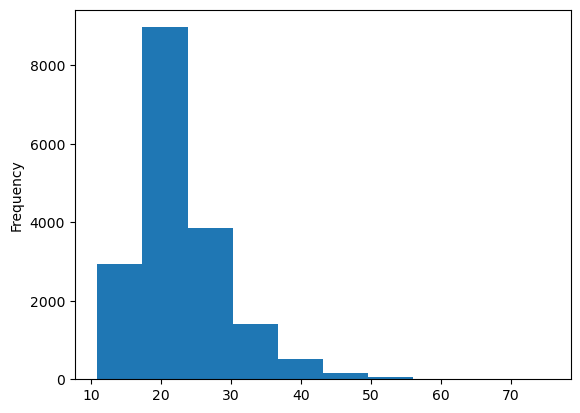

In [6]:
no2_conc.plot.hist()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality4.py
df["no2"].mean()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality5.py
df["no2"].describe()

A histogram:

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality6.py
df['no2'].plot.hist()

A more expanded histogram (not asked in the exercise, but uncomment to check the code)

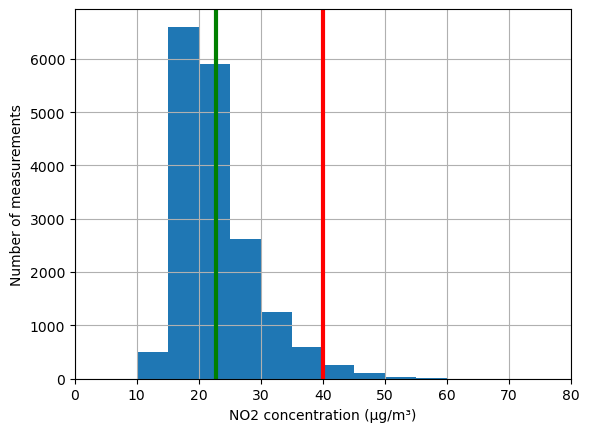

In [26]:
# %load _solutions/case-curieuzeneuzen-air-quality7.py
fig, ax = plt.subplots()
# using predefined bins
no2_conc.plot.hist(ax=ax, bins=np.arange(0, 80, 5))
# adding x/y axis labels, and setting the range for the x axis
ax.set(xlabel="NO2 concentration (µg/m³)",
       ylabel="Number of measurements", xlim=(0,80))
# adding a line with the mean
ax.axvline(x=no2_conc.mean(), color='green', linewidth=3)
# adding a line with the EU yearly limit value of 40 µg/m³
ax.axvline(x=40, color='r', linewidth=3)
ax.grid()

<div class="alert alert-success">

**EXERCISE 4**:

* Determine the percentage of locations that exceed the EU and WHO yearly limit value of 40 µg/m³.

__Tip__: first create a boolean mask determining whether the NO2 concentration is above 40 or not. Using this boolean mask, you can determine the percentage of values that follow the condition.
    
<details><summary>Hints</summary>

* To know the fraction of `True` values in a boolean Series, we can use the `sum()` method, which is equivalent as counting the True values (True=1, False=0, so the sum is a count of the True values) and dividing by the total number of values. 

</details>

</div>

In [7]:
# Set no2 to float
df['no2'] = df['no2'].astype('float')

In [8]:
# 405 locations greater than EU limit
# 2.26%
len(df[df['no2'] > 40]) /len(df) * 100

2.264340825226434

In [9]:
# Alternative solution
(df['no2'] > 40).mean()

0.02264340825226434

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality8.py
exceedances = df['no2'] > 40

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality9.py
exceedances.mean() * 100  # the mean is equivalent here to counting the True values and dividing by the total number of elements

So overall in Flanders, around 2.3% of the measurement locations exceeded the limit value. This might not seem much, but assuming that the dataset is representative for the population of Flanders (and effort was done to ensure this), around 150,000 inhabitants live in a place where the annual NO2 concentration at the front door exceeds the EU legal threshold value.  
We will also later see that this exceedance has a large spatial variation.

<div class="alert alert-success">

**EXERCISE 5**:

* What is the average measured concentration at the background location? Calculate this by first selecting the appropriate subset of the dataframe.
* More generally, what is the average measured concentration grouped on the "Campaign" type? 

<details><summary>Hints</summary>

* To calculate a grouped statistic, use the `groupby()` method. Pass as argument the name of the column on which you want to group.
* After the `groupby()` operation, we can (similarly as for a normal DataFrame) select a column and call the aggregation column (`df.groupby("class")["variable"].method()`).

</details>

</div>

In [10]:
df[df['campaign'] == 'facade']['no2'].mean()

22.789709673803387

In [11]:
df.groupby('campaign')['no2'].mean()

campaign
background           14.756522
facade               22.789710
reference station    25.719048
Name: no2, dtype: float64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality10.py
df[df['campaign'] == "background"]["no2"].mean()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality11.py
df.groupby('campaign')["no2"].mean()

The background locations (parks, nature reserves) clearly show a lower concentration than the average location. Note that the number of observations in each class are very skewed, so those averages are not necessarily representative!

## Converting to a geospatial dataset

The provided data was a CSV file, and we explored it above as a pandas DataFrame. To further explore the dataset using the spatial aspects (point data), we will first convert it to a geopandas GeoDataFrame.

<div class="alert alert-success">

**EXERCISE 6**:

* Convert `df` into a GeoDataFrame, using the 'lat'/'lon' columns to create a Point geometry column (tip: check the `geopandas.points_from_xy()` function). Also specify the correct Coordinate Reference System with the `crs` keyword. Call the result `gdf`.
* Do a quick check to see the result is correct: look at the first rows, and make a simple plot of the GeoDataFrame with `.plot()` (you should recognize the shape of Flanders, if not, something went wrong)

    
<details><summary>Hints</summary>

* A GeoDataFrame can be created from an existing pandas.DataFrame by using the `geopandas.GeoDataFrame(...)` constructor. This constructor needs a `geometry=` keyword specifying either the name of the column that holds the geometries or either the geometry values.
* GeoPandas provides a helper function to create Point geometry values from a array or column of x and y coordinates: `geopandas.points_from_xy(x_values, y_values)`.
* Remember! The order of coordinates is (x, y), and for geographical coordinates this means the (lon, lat) order.
* Remember! The Coordinate Reference System typically used for geographical lon/lat coordinates is "EPSG:4326" (WGS84).

</details>

</div>

<Axes: >

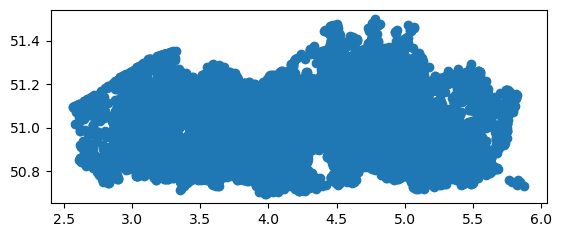

In [12]:
# df[['lat', 'lon']] = df[['lat', 'lon']].astype('float')

gdf = geopandas.GeoDataFrame(df, geometry = geopandas.points_from_xy(x = df['lon'], y = df['lat'], crs = 'EPSG:4326'))

gdf.plot()

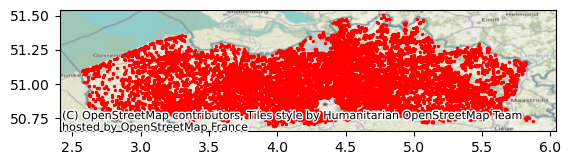

In [13]:
import contextily as cx

f, ax = plt.subplots()

gdf.plot(ax = ax, c = 'r', markersize = 2)

cx.add_basemap(ax = ax, crs = 'EPSG:4326')

In [14]:
gdf.explore()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality12.py
gdf = geopandas.GeoDataFrame(df, geometry=geopandas.points_from_xy(df['lon'], df['lat']), crs="EPSG:4326")

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality13.py
gdf

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality14.py
gdf.plot()

Let's make that last plot a bit more informative:

<div class="alert alert-success">

**EXERCISE 7**:

* Make a plot of the point locations of `gdf` and use the "no2" column to color the points.
* Make the figure a bit larger by specifying the `figsize=` keyword.

<details><summary>Hints</summary>

* The figure size can be specified with the `figsize=` keyword of the `plot()` method.
* For using one of the columns of the GeoDataFrame to determine the fill color, use the `column=` keyword.

</details>

</div>

In [14]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 17886 entries, 0 to 17885
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   code      17886 non-null  object  
 1   campaign  17886 non-null  object  
 2   no2       17886 non-null  float64 
 3   lat       17886 non-null  object  
 4   lon       17886 non-null  object  
 5   geometry  17886 non-null  geometry
dtypes: float64(1), geometry(1), object(4)
memory usage: 838.5+ KB


In [16]:
# Convert lon and lat to float
gdf[['lon', 'lat']] = gdf[['lon', 'lat']].astype('float')

gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 17886 entries, 0 to 17885
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   code      17886 non-null  object  
 1   campaign  17886 non-null  object  
 2   no2       17886 non-null  float64 
 3   lat       17886 non-null  float64 
 4   lon       17886 non-null  float64 
 5   geometry  17886 non-null  geometry
dtypes: float64(3), geometry(1), object(2)
memory usage: 838.5+ KB


CPU times: total: 266 ms
Wall time: 336 ms


(50.5, 51.6)

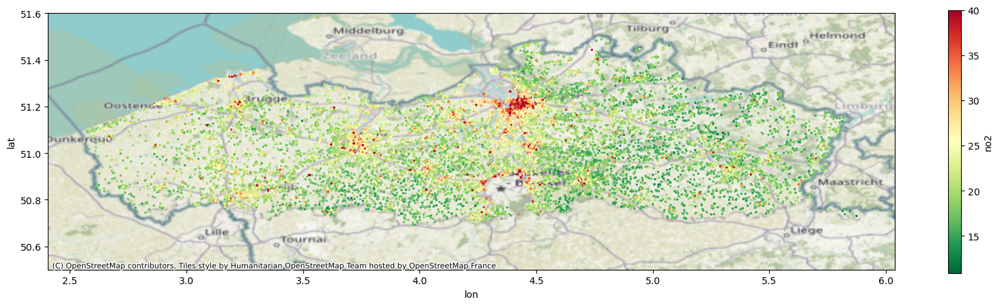

In [17]:
%%time

f, ax = plt.subplots(figsize = (20, 5))

# Set 40 as vmax to show EU limits
gdf.plot.scatter(ax = ax, x = 'lon', y = 'lat', c = 'no2', cmap = 'RdYlGn_r', s = 2, vmax = 40)

cx.add_basemap(ax = ax, crs = 'EPSG:4326')

ax.set_ylim(50.5, 51.6)

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality15.py
gdf.plot(column="no2", figsize=(20, 10))

We can already notice some spatial patterns: higher concentrations (and also more measurement locations) in urban areas. But, the visualization above is not really a good way to visualize many points. There are many alternatives (e.g. heatmaps, hexbins, etc), but in this case study we are going to make a [*choropleth* map](https://en.wikipedia.org/wiki/Choropleth_map): choropleths are maps onto which an attribute, a non-spatial variable, is displayed by coloring a certain area. 

As the unit of area, we will use the municipalities of Flanders.

## Combining with municipalities

We downloaded the publicly available municipality reference from geopunt.be ([Voorlopig referentiebestand gemeentegrenzen, toestand 16/05/2018](https://www.geopunt.be/catalogus/datasetfolder/9ff44cc4-5f16-4507-81a6-6810958b14df)), and added the Shapefile with the borders to the course repo: `data/VRBG/Refgem.shp`.

<div class="alert alert-success">

**EXERCISE 8**:

* Read the Shapefile with the municipalities into a variable called `muni`.
* Inspect the data and do a quick plot.
    
</div>

In [18]:
muni = geopandas.read_file('data/VRBG/Refgem.shp')

muni

,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,geometry
0,278.0,278.0,1900-01-01,1,1976-01-23,1975123003,13001,Arendonk,32278.608018,5.501111e+07,"POLYGON ((198892.290 231761.690, 202087.220 22..."
1,209.0,209.0,1900-01-01,2,1982-12-29,1982001920,13031,Oud-Turnhout,33317.260657,3.917257e+07,"POLYGON ((191910.672 228249.047, 192000.239 22..."
2,67.0,67.0,1900-01-01,3,1831-02-07,NaN,13025,Mol,77705.294504,1.144999e+08,"POLYGON ((203378.850 223128.860, 205356.450 22..."
3,53.0,53.0,1900-01-01,4,1976-01-23,1975123003,72037,Hamont-Achel,31929.641885,4.373537e+07,"POLYGON ((230005.370 221212.320, 230240.580 22..."
4,102.0,102.0,1900-01-01,5,1982-12-29,1982001920,13036,Retie,35339.133575,4.865207e+07,"POLYGON ((200827.109 220823.391, 201389.922 22..."
...,...,...,...,...,...,...,...,...,...,...,...
295,314.0,314.0,1900-01-01,366,2018-06-01,2018012104,45068,Kruisem,54007.558791,7.159178e+07,"POLYGON ((91858.461 182565.469, 91657.680 1820..."
296,313.0,313.0,1900-01-01,367,2018-06-01,2018012109,44084,Aalter,60976.545945,1.198606e+08,"POLYGON ((83118.393 205870.225, 83269.336 2059..."
297,315.0,315.0,1900-01-01,368,2018-06-01,2018012108,44083,Deinze,82273.711221,1.280527e+08,"POLYGON ((95156.969 199099.729, 95288.360 1990..."
298,311.0,311.0,1900-01-01,369,2018-06-01,2018012103,12041,Puurs-Sint-Amands,39898.949253,4.930680e+07,"POLYGON ((148031.891 198397.031, 148317.000 19..."


In [19]:
muni.explore()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality16.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality17.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality18.py

Now we have a dataset with the municipalities, we want to know for each of the measurement locations in which municipality it is located. This is a "point-in-polygon" spatial join.

<div class="alert alert-success">

**EXERCISE 9**:

Before performing the spatial join, we need to ensure the two datasets are using the same Coordinate Reference System (CRS).

* Check the CRS of both `gdf` and `muni`. What kind of CRS are they using? Are they the same?
* Reproject the measurements to the Lambert 72 (EPSG:31370) reference system. Call the result `gdf_lambert`.

<details><summary>Hints</summary>

* The CRS of a GeoDataFrame can be checked by looking at the `crs` attribute.
* To reproject a GeoDataFrame to another CRS, we can use the `to_crs()` method.

</details>

</div>

In [20]:
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [21]:
muni.crs

<Projected CRS: EPSG:31370>
Name: BD72 / Belgian Lambert 72
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: Belgium - onshore.
- bounds: (2.5, 49.5, 6.4, 51.51)
Coordinate Operation:
- name: Belgian Lambert 72
- method: Lambert Conic Conformal (2SP)
Datum: Reseau National Belge 1972
- Ellipsoid: International 1924
- Prime Meridian: Greenwich

In [27]:
# Remember - always easier to convert vector to different CRS than raster
gdf = gdf.to_crs('EPSG:31370')

In [28]:
gdf_muni = gdf.sjoin(muni, how = 'inner', predicate = 'within')

In [29]:
gdf_muni

,code,campaign,no2,lat,lon,geometry,index_right,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL
0,1387656,facade,23.0,50.825940,4.704003,POINT (173620.682 168443.754),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07
79,194382,facade,21.2,50.832260,4.726776,POINT (175221.784 169154.289),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07
544,199500,facade,19.3,50.838730,4.663526,POINT (170763.161 169854.380),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07
1047,204192,facade,13.7,50.810110,4.649417,POINT (169781.426 166666.852),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07
1207,205932,facade,18.5,50.830579,4.731757,POINT (175573.590 168968.961),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12021,300444,facade,17.7,50.967750,2.727611,POINT (34728.149 185438.362),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07
12403,303708,facade,17.5,50.955390,2.810107,POINT (40492.844 183938.884),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07
12760,307062,facade,30.8,50.980170,2.743235,POINT (35855.615 186795.563),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07
13922,317490,facade,21.4,50.979830,2.748535,POINT (36226.898 186749.618),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07


In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality19.py
gdf.crs

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality20.py
muni.crs

In [30]:
# %load _solutions/case-curieuzeneuzen-air-quality21.py
gdf_lambert = gdf.to_crs("EPSG:31370")  # or .to_crs(muni.crs)
gdf_lambert.head()

,code,campaign,no2,lat,lon,geometry
0,1387656,facade,23.0,50.82594,4.704003,POINT (173620.682 168443.754)
1,192852,facade,47.3,51.21328,4.444702,POINT (155306.731 211483.310)
2,192873,facade,21.2,51.30897,4.188672,POINT (137441.957 222141.788)
3,192876,facade,26.6,51.09620,3.991424,POINT (123567.247 198522.091)
4,192879,facade,25.6,51.19922,4.461859,POINT (156507.579 209920.455)


The EPSG:31370 or "Belgian Lambert 72" (https://epsg.io/31370) is the local, projected CRS most often used in Belgium.

<div class="alert alert-success">

**EXERCISE 10**:

* Add the municipality information to the measurements dataframe. We are mostly interested in the "NAAM" column of the municipalities dataframe (the name of the municipality). Call the result `gdf_combined`.
    
<details><summary>Hints</summary>

* Joining the measurement locations with the municipality information can be done with the `geopandas.sjoin()` function. The first argument is the dataframe to which we want to add information, the second argument the dataframe with the additional information.
* You can select a subset of columns when passing a GeoDataFrame to the `sjoin()` function.

</details>

</div>

In [31]:
# %load _solutions/case-curieuzeneuzen-air-quality22.py
gdf_combined = geopandas.sjoin(gdf_lambert, muni[["NAAM", "geometry"]])

In [32]:
# %load _solutions/case-curieuzeneuzen-air-quality23.py
gdf_combined.head()

,code,campaign,no2,lat,lon,geometry,index_right,NAAM
0,1387656,facade,23.0,50.825940,4.704003,POINT (173620.682 168443.754),258,Oud-Heverlee
79,194382,facade,21.2,50.832260,4.726776,POINT (175221.784 169154.289),258,Oud-Heverlee
544,199500,facade,19.3,50.838730,4.663526,POINT (170763.161 169854.380),258,Oud-Heverlee
1047,204192,facade,13.7,50.810110,4.649417,POINT (169781.426 166666.852),258,Oud-Heverlee
1207,205932,facade,18.5,50.830579,4.731757,POINT (175573.590 168968.961),258,Oud-Heverlee


In [33]:
len(gdf_combined)

17880

<div class="alert alert-success">

**EXERCISE 11**:

* What is the average measured concentration in each municipality?
* Call the result `muni_mean`. Ensure we have a DataFrame with a NO2 columns and a column with the municipality name by calling the `reset_index()` method after the groupby operation.
* Merge those average concentrations with the municipalities GeoDataFrame (note: those have a common column "NAAM"). Call the merged dataframe `muni_no2`, and check the first rows.
    
<details><summary>Hints</summary>

* Something like `df.groupby("class")["variable"].mean()` returns a Series, with the group variable as the index. Calling `reset_index()` on the result then converts this into a DataFrame with 2 columns: the group variable and the calculated statistic.
* Merging two dataframe that have a common column can be done with the `pd.merge()` function. 

</details>

</div>

In [34]:
muni_mean = gdf_muni.groupby('NAAM')['no2'].mean().reset_index()

muni_mean

,NAAM,no2
0,Aalst,25.170196
1,Aalter,20.734951
2,Aarschot,19.738710
3,Aartselaar,28.256604
4,Affligem,24.745455
...,...,...
294,Zulte,20.252500
295,Zutendaal,17.957143
296,Zwalm,17.996970
297,Zwevegem,20.766102


In [35]:
muni

,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,geometry
0,278.0,278.0,1900-01-01,1,1976-01-23,1975123003,13001,Arendonk,32278.608018,5.501111e+07,"POLYGON ((198892.290 231761.690, 202087.220 22..."
1,209.0,209.0,1900-01-01,2,1982-12-29,1982001920,13031,Oud-Turnhout,33317.260657,3.917257e+07,"POLYGON ((191910.672 228249.047, 192000.239 22..."
2,67.0,67.0,1900-01-01,3,1831-02-07,NaN,13025,Mol,77705.294504,1.144999e+08,"POLYGON ((203378.850 223128.860, 205356.450 22..."
3,53.0,53.0,1900-01-01,4,1976-01-23,1975123003,72037,Hamont-Achel,31929.641885,4.373537e+07,"POLYGON ((230005.370 221212.320, 230240.580 22..."
4,102.0,102.0,1900-01-01,5,1982-12-29,1982001920,13036,Retie,35339.133575,4.865207e+07,"POLYGON ((200827.109 220823.391, 201389.922 22..."
...,...,...,...,...,...,...,...,...,...,...,...
295,314.0,314.0,1900-01-01,366,2018-06-01,2018012104,45068,Kruisem,54007.558791,7.159178e+07,"POLYGON ((91858.461 182565.469, 91657.680 1820..."
296,313.0,313.0,1900-01-01,367,2018-06-01,2018012109,44084,Aalter,60976.545945,1.198606e+08,"POLYGON ((83118.393 205870.225, 83269.336 2059..."
297,315.0,315.0,1900-01-01,368,2018-06-01,2018012108,44083,Deinze,82273.711221,1.280527e+08,"POLYGON ((95156.969 199099.729, 95288.360 1990..."
298,311.0,311.0,1900-01-01,369,2018-06-01,2018012103,12041,Puurs-Sint-Amands,39898.949253,4.930680e+07,"POLYGON ((148031.891 198397.031, 148317.000 19..."


In [36]:
# muni.join doesn't work for some reason
muni_no2 = pd.merge(muni, muni_mean, on = 'NAAM')

muni_no2

,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,geometry,no2
0,278.0,278.0,1900-01-01,1,1976-01-23,1975123003,13001,Arendonk,32278.608018,5.501111e+07,"POLYGON ((198892.290 231761.690, 202087.220 22...",18.921053
1,209.0,209.0,1900-01-01,2,1982-12-29,1982001920,13031,Oud-Turnhout,33317.260657,3.917257e+07,"POLYGON ((191910.672 228249.047, 192000.239 22...",17.872973
2,67.0,67.0,1900-01-01,3,1831-02-07,NaN,13025,Mol,77705.294504,1.144999e+08,"POLYGON ((203378.850 223128.860, 205356.450 22...",19.103061
3,53.0,53.0,1900-01-01,4,1976-01-23,1975123003,72037,Hamont-Achel,31929.641885,4.373537e+07,"POLYGON ((230005.370 221212.320, 230240.580 22...",17.855172
4,102.0,102.0,1900-01-01,5,1982-12-29,1982001920,13036,Retie,35339.133575,4.865207e+07,"POLYGON ((200827.109 220823.391, 201389.922 22...",18.064286
...,...,...,...,...,...,...,...,...,...,...,...,...
294,314.0,314.0,1900-01-01,366,2018-06-01,2018012104,45068,Kruisem,54007.558791,7.159178e+07,"POLYGON ((91858.461 182565.469, 91657.680 1820...",21.526531
295,313.0,313.0,1900-01-01,367,2018-06-01,2018012109,44084,Aalter,60976.545945,1.198606e+08,"POLYGON ((83118.393 205870.225, 83269.336 2059...",20.734951
296,315.0,315.0,1900-01-01,368,2018-06-01,2018012108,44083,Deinze,82273.711221,1.280527e+08,"POLYGON ((95156.969 199099.729, 95288.360 1990...",21.184071
297,311.0,311.0,1900-01-01,369,2018-06-01,2018012103,12041,Puurs-Sint-Amands,39898.949253,4.930680e+07,"POLYGON ((148031.891 198397.031, 148317.000 19...",22.371111


In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality24.py
muni_mean = gdf_combined.groupby("NAAM")["no2"].mean()
muni_mean.head()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality25.py
muni_mean = muni_mean.reset_index()
muni_mean.head()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality26.py
muni_no2 = pd.merge(muni, muni_mean, on="NAAM")
muni_no2.head()

<div class="alert alert-success">

**EXERCISE 12**:

* Make a choropleth of the municipalities using the average NO2 concentration as variable to color the municipality polygons.
* Set the figure size to be (16, 5), and add a legend.
    
<details><summary>Hints</summary>

* To specify which column to use to color the geometries in the plot, use the `column=` keyword of the `plot()` method.
* The figure size can be specified with the `figsize=` keyword of the `plot()` method.
* Pass `legend=True` to add a legend to the plot. The type of legend (continuous color bar, discrete legend) will be inferred from the plotted values.

</details>

</div>

<Axes: >

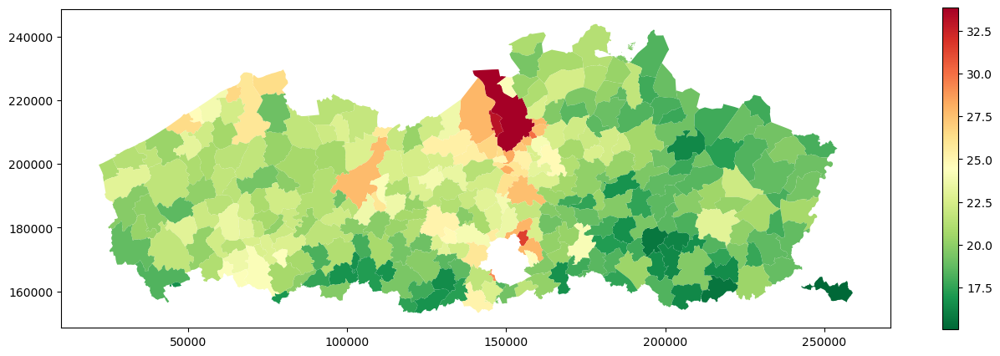

In [37]:
f, ax = plt.subplots(figsize = (16, 5))

muni_no2.plot(ax = ax, column = 'no2', cmap = "RdYlGn_r", legend = True)

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality27.py

When specifying a numerical column to color the polygons, by default this results in a continuous color scale, as you can see above.

However, it is very difficult for the human eye to process small differences in color in a continuous scale. 
Therefore, to create effective choropleths, we typically classify the values into a set of discrete groups.

With GeoPandas' `plot()` method, you can control this with the `scheme` keyword (indicating which classification scheme to use, i.e how to divide the continuous range into a set of discrete classes) and the `k` keyword to indicate how many classes to use. This uses the [mapclassify](https://pysal.org/mapclassify/) package under the hood.

<div class="alert alert-success">

**EXERCISE 13**:

* Starting from the previous figure, specify a classification scheme and a number of classes to use. Check the help of the `plot()` method to see the different options, and experiment with those.
    
</div>

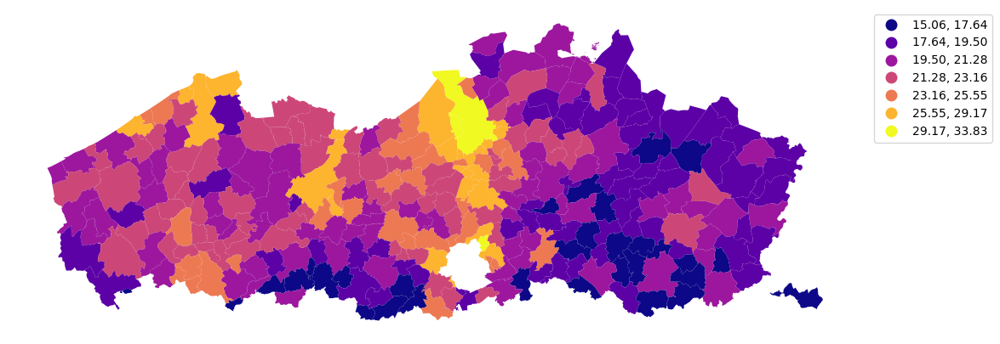

In [38]:
f, ax = plt.subplots(figsize = (16, 5))

# Scheme refers to interquartile, etc. see documentation
muni_no2.plot(ax = ax, column = 'no2', scheme = "FisherJenks", k = 7, legend = True, cmap = "plasma")

# Move the legend outside the plot
ax.get_legend().set_bbox_to_anchor((1.16, 1))
ax.set_axis_off()
plt.show()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality28.py
ax = muni_no2.plot(column="no2", figsize=(16, 5), legend=True, scheme="FisherJenks", k=7, cmap="plasma")
ax.set_axis_off()

<div class="alert alert-success">

**EXERCISE 14**:

* What is the percentage of exceedance for each municipality? Repeat the same calculation we did earlier on the original dataset `df`, but now using `gdf_combined` and grouped per municipality.
* Show the 10 municipalities with the highest percentage of exceedances.

<details><summary>Hints</summary>

* For showing the 10 highest values, we can either use the `sort_values()` sorting the highest values on top and showing the first 10 rows, or either use the `nlargest()` method as a short cut for this operation.
</details>

</div>

In [39]:
# Bit complicated but the only way
gdf_muni['exceedence'] = gdf_muni['no2'] > 40

gdf_muni.groupby('NAAM')['exceedence'].mean().sort_values(ascending = False).head(10)

NAAM
Antwerpen      0.171144
Vilvoorde      0.078947
Asse           0.064935
Melle          0.061224
Mechelen       0.060086
Berlare        0.058824
Zwijndrecht    0.057143
Dilbeek        0.056000
Gent           0.053218
Kaprijke       0.052632
Name: exceedence, dtype: float64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality29.py
gdf_combined["exceedance"] = gdf_combined["no2"] > 40

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality30.py
exceedances_muni = gdf_combined.groupby("NAAM")["exceedance"].mean() * 100

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality31.py
exceedances_muni.sort_values(ascending=False).head(10)

## Combining with Land Use data

The CORINE Land Cover (https://land.copernicus.eu/pan-european/corine-land-cover) is a program by the European Environment Agency (EEA) to provide an inventory of land cover in 44 classes of the European Union. The data is provided in both raster as vector format and with a resolution of 100m.

The data for the whole of Europe can be downloaded from the website (latest version: https://land.copernicus.eu/pan-european/corine-land-cover/clc2018?tab=download). This is however a large dataset, so we downloaded the raster file and cropped it to cover Flanders, and this subset is included in the repo as `data/CLC2018_V2020_20u1_flanders.tif` (the code to do this cropping can be see at [data/preprocess_data.ipynb#CORINE-Land-Cover](data/preprocess_data.ipynb#CORINE-Land-Cover)).

The air quality is indirectly linked to land use, as the presence of pollution sources will depend on the land use. Therefore, in the following section we will determine the land use for each of the measurement locations based on the CORINE dataset and explore the relationship of the NO2 concentration and land use.

<div class="alert alert-success">

**EXERCISE 15**:

* Open the land cover raster file (`data/CLC2018_V2020_20u1_flanders.tif`) with xarray, inspect the metadata, and do a quick visualization.

<details><summary>Hints</summary>

* The tif file represents a single layer (with one band), so you can use `xarray.open_dataarray()` to read it into an xarray.DataArray.
* With `mask_and_scale=False` the `int8` data type will be kept when reading in the data.

</details>

</div>

In [40]:
import xarray as xr

land_cover = xr.open_dataarray('data/CLC2018_V2020_20u1_flanders.tif', mask_and_scale=False)

land_cover

<xarray.DataArray 'band_data' (band: 1, y: 1133, x: 2530)>
[2866490 values with dtype=int8]
Coordinates:
  * band         (band) int32 1
  * x            (x) float64 3.79e+06 3.79e+06 3.79e+06 ... 4.042e+06 4.042e+06
  * y            (y) float64 3.178e+06 3.178e+06 ... 3.065e+06 3.065e+06
    spatial_ref  int32 ...
Attributes:
    AREA_OR_POINT:  Area
    _FillValue:     -128
    scale_factor:   1.0
    add_offset:     0.0

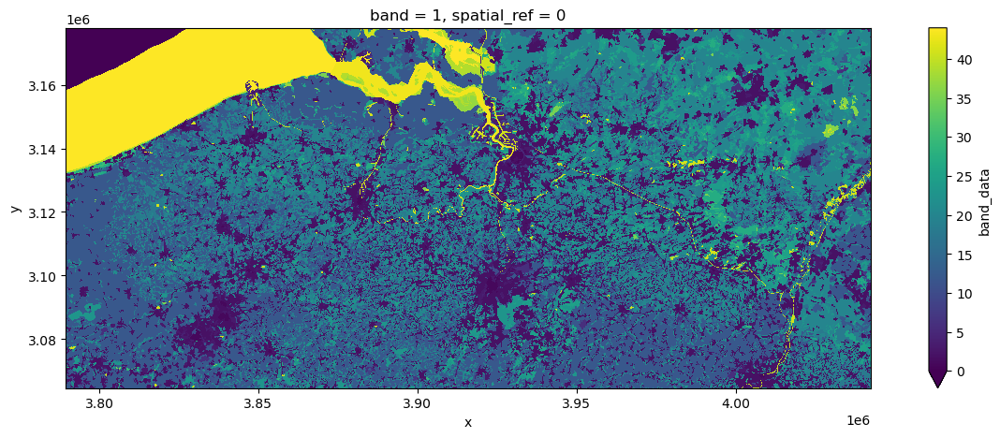

In [41]:
f, ax = plt.subplots(figsize = (16,5))
land_cover.plot(ax = ax, vmin = 0)
ax.set_aspect('equal')

In [146]:
# %load _solutions/case-curieuzeneuzen-air-quality32.py
import xarray

raster = xarray.open_dataarray("data/CLC2018_V2020_20u1_flanders.tif", engine="rasterio", mask_and_scale=False)
raster

<xarray.DataArray 'band_data' (band: 1, y: 1133, x: 2530)>
[2866490 values with dtype=int8]
Coordinates:
  * band         (band) int32 1
  * x            (x) float64 3.79e+06 3.79e+06 3.79e+06 ... 4.042e+06 4.042e+06
  * y            (y) float64 3.178e+06 3.178e+06 ... 3.065e+06 3.065e+06
    spatial_ref  int32 ...
Attributes:
    AREA_OR_POINT:  Area
    _FillValue:     -128
    scale_factor:   1.0
    add_offset:     0.0

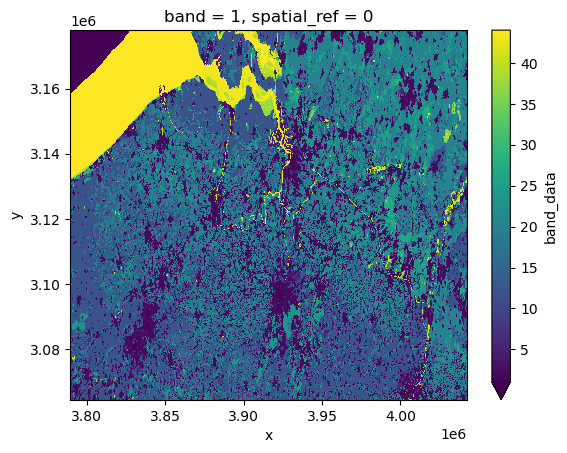

In [147]:
# %load _solutions/case-curieuzeneuzen-air-quality33.py
raster.plot(vmin=1, vmax=44)

The goal is now to query from the raster file the value of the land cover class for each of the measurement locations. This can be done with the `rasterstats` package and with the point locations of our GeoDataFrame. But first, we need to ensure that both our datasets are using the same CRS. In this case, it's easiest to reproject the point locations to the CRS of the raster file.

<div class="alert alert-success">

**EXERCISE 16**:

* What is the EPSG code of the Coordinate Reference System (CRS) of the raster file? You can find this in the metadata inspected with rasterio or xarray above.
* Reproject the point dataframe (`gdf`) to the CRS of the raster and assign this to a temporary variable `gdf_raster`.

<details><summary>Hints</summary>

* Reprojecting can be done with the `to_crs()` method of a GeoDataFrame, and the CRS can be specified in the form of "EPSG:xxxx".

</details>

</div>

In [42]:
land_cover.rio.crs

CRS.from_epsg(3035)

In [43]:
# Reproject
gdf_raster = gdf_muni.to_crs('EPSG:3035')

gdf_raster

,code,campaign,no2,lat,lon,geometry,index_right,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,exceedence
0,1387656,facade,23.0,50.825940,4.704003,POINT (3948208.393 3092876.640),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False
79,194382,facade,21.2,50.832260,4.726776,POINT (3949858.511 3093462.372),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False
544,199500,facade,19.3,50.838730,4.663526,POINT (3945467.991 3094503.304),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False
1047,204192,facade,13.7,50.810110,4.649417,POINT (3944246.042 3091399.195),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False
1207,205932,facade,18.5,50.830579,4.731757,POINT (3950195.011 3093250.479),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12021,300444,facade,17.7,50.967750,2.727611,POINT (3811101.243 3120533.683),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False
12403,303708,facade,17.5,50.955390,2.810107,POINT (3816729.508 3118592.022),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False
12760,307062,facade,30.8,50.980170,2.743235,POINT (3812328.718 3121800.820),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False
13922,317490,facade,21.4,50.979830,2.748535,POINT (3812695.098 3121726.285),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False


In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality34.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality35.py

<div class="alert alert-success">

**EXERCISE 17**:

* Use the `rasterstats.point_query()` function to determine the value of the raster for each of the points in the dataframe. Remember to use `gdf_raster` for passing the geometries.
* Because we have a raster file with discrete classes, ensure to pass `interpolate="nearest"` (the default "bilinear" will result in floats with decimals, not preserving the integers representing discrete classes).
* Assign the result to a new column "land_use" in `gdf`.
* Perform a `value_counts()` on this new column do get a quick idea of the new values obtained from the raster file.

Note that the query operation can take a while. Don't worry if it runs for around 20 seconds!
    
    
<details><summary>Hints</summary>

* Don't forget to first import the `rasterstats` package.
* The `point_query()` function takes as first argument the point geometries (this can be passed as a GeoSeries), and as second argument the path to the raster file (this will be opened by `rasterio` under the hood).

</details>

</div>

In [45]:
import rasterstats

rasterstats.point_query

<function rasterstats.point.point_query(*args, **kwargs)>

In [46]:
# Note that rasterstats wants you to point to the actual tif file
# Also note that this takes fucking AGES
# Do not interpolate = "biliear" <- this makes no sense with landuse data

# This generates a list of values rather than a generator object
# rasterstats.point_query(gdf_raster, 'data/CLC2018_V2020_20u1_flanders.tif', interpolate = "nearest")

In [47]:
%%time

land_use_gen = rasterstats.gen_point_query(gdf_raster.geometry, 'data/CLC2018_V2020_20u1_flanders.tif', interpolate = "nearest")

print(type(land_use_gen))

gdf_raster['land_use'] = list(land_use_gen)

<class 'generator'>
CPU times: total: 48.6 s
Wall time: 1min


In [48]:
gdf_raster['land_use'].value_counts()

land_use
2     14622
20      938
1       604
12      504
21      348
3       277
18      234
11       69
25       61
24       56
23       46
4        44
16       18
10       15
5        15
27        7
40        5
29        4
43        4
41        3
26        2
35        1
37        1
9         1
30        1
Name: count, dtype: int64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality36.py
import rasterstats

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality37.py
gdf['land_use'] = rasterstats.point_query(gdf_raster.geometry, "data/CLC2018_V2020_20u1_flanders.tif", interpolate='nearest')

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality38.py
gdf['land_use'].value_counts()

As you can see, we have obtained a large variety of land cover classes. To make this more practical to work with, we 

 1. want to convert the numbers into a class name, and 
 2. reduce the number of classes.

The full hierarchy (with 3 levels) of the 44 classes can be seen at https://wiki.openstreetmap.org/wiki/Corine_Land_Cover. For keeping the exercise a bit practical here, we prepared a simplified set of classes and provided a csv file with this information.  

This has a column "value" corresponding to the values used in the raster file, and a "group" column with the simplified classes that we will use for this exercise.

<div class="alert alert-success">

**EXERCISE 18**:

* Read the `"data/CLC2018_V2018_legend_grouped.csv"` as a dataframe and call it `legend`.

The additional steps, provided for you, use this information to convert the column of integer land use classes to a column with the simplified names. After that, we again use `value_counts()` on this new column, and we can see that we now have less classes.

<details><summary>Hints</summary>

* Reading a csv file can be done with the `pandas.read_csv()` function.

</details>

</div>

In [49]:
legend = pd.read_csv('data/CLC2018_V2018_legend_grouped.csv')

legend.head()

,code,value,class,group
0,111,1,Continuous urban fabric,Continuous urban fabric
1,112,2,Discontinuous urban fabric,Discontinuous urban fabric
2,121,3,Industrial or commercial units,Industrial or commercial units
3,122,4,Road and rail networks and associated land,Transport units
4,123,5,Port areas,Transport units


In [175]:
gdf_land_raster = pd.merge(gdf_raster, legend, left_on = 'land_use', right_on = 'value')

gdf_land_raster['class'].value_counts()

class
Discontinuous urban fabric                                                               14622
Complex cultivation patterns                                                               938
Continuous urban fabric                                                                    604
Non-irrigated arable land                                                                  504
Land principally occupied by agriculture with significant areas of natural vegetation      348
Industrial or commercial units                                                             277
Pastures                                                                                   234
Sport and leisure facilities                                                                69
Mixed forest                                                                                61
Coniferous forest                                                                           56
Broad-leaved forest                         

In [97]:
# Alternative solution using dictionaries
land_use_dict = {code:land_use for code, land_use in zip(legend['value'], legend['group'])}

land_use_dict

{1: 'Continuous urban fabric',
 2: 'Discontinuous urban fabric',
 3: 'Industrial or commercial units',
 4: 'Transport units',
 5: 'Transport units',
 6: 'Transport units',
 7: 'Mine, dump and construction sites',
 8: 'Mine, dump and construction sites',
 9: 'Mine, dump and construction sites',
 10: 'Green urban areas',
 11: 'Green urban areas',
 12: 'Agricultural areas ',
 13: 'Agricultural areas ',
 14: 'Agricultural areas ',
 15: 'Agricultural areas ',
 16: 'Agricultural areas ',
 17: 'Agricultural areas ',
 18: 'Agricultural areas ',
 19: 'Agricultural areas ',
 20: 'Agricultural areas ',
 21: 'Agricultural areas ',
 22: 'Agricultural areas ',
 23: 'Forest and seminatural areas',
 24: 'Forest and seminatural areas',
 25: 'Forest and seminatural areas',
 26: 'Forest and seminatural areas',
 27: 'Forest and seminatural areas',
 28: 'Forest and seminatural areas',
 29: 'Forest and seminatural areas',
 30: 'Forest and seminatural areas',
 31: 'Forest and seminatural areas',
 32: 'Forest

In [98]:
# Very easy to map using dictionary
gdf_raster['land_use_class'] = gdf_raster['land_use'].map(land_use_dict)

gdf_raster

,code,campaign,no2,lat,lon,geometry,index_right,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,exceedence,land_use,land_use_class
0,1387656,facade,23.0,50.825940,4.704003,POINT (3948208.393 3092876.640),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
79,194382,facade,21.2,50.832260,4.726776,POINT (3949858.511 3093462.372),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
544,199500,facade,19.3,50.838730,4.663526,POINT (3945467.991 3094503.304),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
1047,204192,facade,13.7,50.810110,4.649417,POINT (3944246.042 3091399.195),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
1207,205932,facade,18.5,50.830579,4.731757,POINT (3950195.011 3093250.479),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12021,300444,facade,17.7,50.967750,2.727611,POINT (3811101.243 3120533.683),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,12,Agricultural areas
12403,303708,facade,17.5,50.955390,2.810107,POINT (3816729.508 3118592.022),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,20,Agricultural areas
12760,307062,facade,30.8,50.980170,2.743235,POINT (3812328.718 3121800.820),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,2,Discontinuous urban fabric
13922,317490,facade,21.4,50.979830,2.748535,POINT (3812695.098 3121726.285),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,2,Discontinuous urban fabric


In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality39.py
legend = pd.read_csv("data/CLC2018_V2018_legend_grouped.csv")
legend

Convert the "land_use" integer values to a column with land use class names:

In [ ]:
value_to_group = dict(zip(legend['value'], legend['group']))

In [ ]:
# Nice alternative using dictionary - apparently .map works as well
gdf['land_use_class'] = gdf['land_use'].replace(value_to_group)

In [ ]:
gdf['land_use_class'].value_counts()

Now we have the land use data, let's explore the air quality in relation to this land use.

We can see in the `value_counts()` result  above that we have a few classes with only very few observations, though (<50). Calculating statistics for those small groups is not very reliable, so lets leave them out for this exercises (note, this is not necessarily the best strategy in real life! Amongst others, we could also inspect those points and re-assign to a dominant land use class in the surrounding region).

<div class="alert alert-success">

**EXERCISE 19**:

* Assign the value counts of the "land_use_class" column to a variable `counts`. 
* Using "counts", we can determine which classes occur more then 50 times. 
* Using those frequent classes, filter the `gdf` to only include observations from those classes, and call this `subset`.
* Based on this subset, calculate the average NO2 concentration per land use class.


</div>

In [103]:
counts = gdf_raster['land_use_class'].value_counts()

counts.head(), type(counts)

(land_use_class
 Discontinuous urban fabric        14622
 Agricultural areas                 2042
 Continuous urban fabric             604
 Industrial or commercial units      277
 Forest and seminatural areas        177
 Name: count, dtype: int64,
 pandas.core.series.Series)

In [100]:
# Yup, correct methodology
# although easier to do counts.index[counts > 50]
frequent = counts[counts > 50].index.to_list()

subset = gdf_raster[gdf_raster['land_use_class'].isin(frequent)]

subset

,code,campaign,no2,lat,lon,geometry,index_right,OIDN,UIDN,VERSDATUM,TERRID,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,exceedence,land_use,land_use_class
0,1387656,facade,23.0,50.825940,4.704003,POINT (3948208.393 3092876.640),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
79,194382,facade,21.2,50.832260,4.726776,POINT (3949858.511 3093462.372),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
544,199500,facade,19.3,50.838730,4.663526,POINT (3945467.991 3094503.304),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
1047,204192,facade,13.7,50.810110,4.649417,POINT (3944246.042 3091399.195),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
1207,205932,facade,18.5,50.830579,4.731757,POINT (3950195.011 3093250.479),258,20.0,20.0,1900-01-01,283,1982-12-29,1982001920,24086,Oud-Heverlee,40326.157812,3.116751e+07,False,2,Discontinuous urban fabric
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12021,300444,facade,17.7,50.967750,2.727611,POINT (3811101.243 3120533.683),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,12,Agricultural areas
12403,303708,facade,17.5,50.955390,2.810107,POINT (3816729.508 3118592.022),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,20,Agricultural areas
12760,307062,facade,30.8,50.980170,2.743235,POINT (3812328.718 3121800.820),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,2,Discontinuous urban fabric
13922,317490,facade,21.4,50.979830,2.748535,POINT (3812695.098 3121726.285),182,33.0,33.0,1900-01-01,198,1982-12-29,1982001920,32030,Lo-Reninge,52896.089142,6.338286e+07,False,2,Discontinuous urban fabric


In [101]:
# Average no2 conc per land use class
# Makes a lot of sense
subset.groupby('land_use_class')['no2'].mean().sort_values(ascending = False)

land_use_class
Continuous urban fabric           34.367715
Transport units                   32.996610
Industrial or commercial units    25.736462
Discontinuous urban fabric        22.780427
Green urban areas                 22.376190
Agricultural areas                19.147160
Forest and seminatural areas      17.427684
Name: no2, dtype: float64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality40.py
counts = gdf['land_use_class'].value_counts()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality41.py
frequent_categories = counts.index[counts > 50]

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality42.py
subset = gdf[gdf["land_use_class"].isin(frequent_categories)]

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality43.py
subset.groupby("land_use_class")['no2'].mean()

<div class="alert alert-success">

**EXERCISE 20**:

* Using the `seaborn` package and the `subset` DataFrame, make a boxplot of the NO2 concentration, splitted per land use class.

Don't forget to first import `seaborn`. We can use the `seaborn.boxplot()` function (check the help of this function to see which keywords to specify).
    
<details><summary>Hints</summary>

* With the `seaborn.boxplot()`, we can specify the `data=` keyword to pass the DataFrame from which to plot values, and the `x=` and `y=` keywords to specify which columns of the DataFrame to use.

</details>

</div>

<Axes: xlabel='no2', ylabel='land_use_class'>

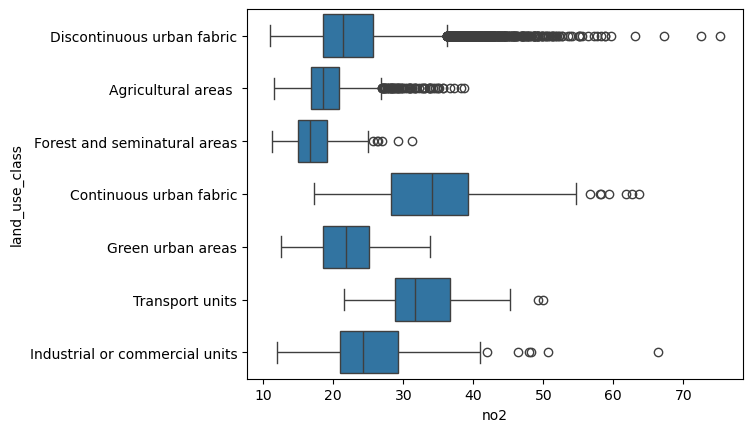

In [102]:
import seaborn as sns

f, ax = plt.subplots()
sns.boxplot(data = subset, y = 'land_use_class', x = 'no2', orient = 'horizontal')

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality44.py
import seaborn

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality45.py
seaborn.boxplot(y="land_use_class", x="no2", data=subset)

Tweaking the figure a bit more (not asked in the exercise, but uncomment and run to see):

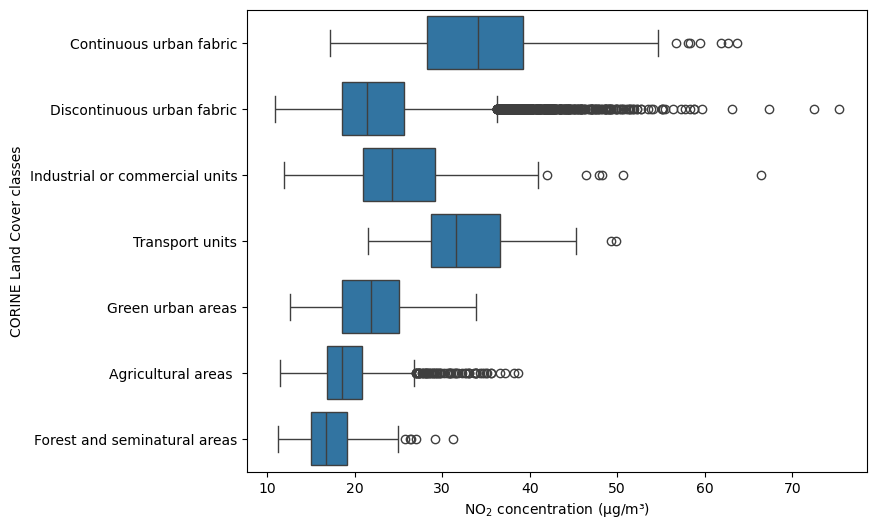

In [104]:
# %load _solutions/case-curieuzeneuzen-air-quality46.py
# defining custom order of the classes (following the order in the CORINE hierarchy as defined in the legend csv)
classes = legend["group"].unique()
# but removing the infrequent ones
counts = gdf_raster['land_use_class'].value_counts()
frequent_categories = counts[counts > 50].index
classes = [value for value in classes if value in frequent_categories]

fig, ax = plt.subplots(figsize=(8, 6))
sns.boxplot(y="land_use_class", x="no2", data=subset, ax=ax, color="C0", order=classes)
ax.set(xlabel="NO$_2$ concentration (µg/m³)", ylabel="CORINE Land Cover classes");

The dense urban areas and areas close to large roads clearly have higher concentrations on average. On the countryside (indicated by "agricultural" areas) much lower concentrations are observed.

## A focus on Gent

Let's now focus on the measurements in Ghent. We first get the geometry of Gent from the municipalities dataframe, so we can use this to filter the measurements:

In [105]:
gent = muni[muni["NAAM"] == "Gent"].geometry.item()

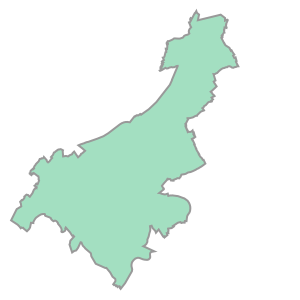

In [106]:
gent

<div class="alert alert-success">

**EXERCISE 21**:

For the exercise here, we don't want to select just the measurements in the municipality of Gent, but those in the region. For this, we will create a bounding box of Gent:
    
* Create a new Shapely geometry, `gent_region`, that defines the bounding box of the Gent municipality.

Check this section of the Shapely docs (https://shapely.readthedocs.io/en/latest/manual.html#constructive-methods) or experiment yourself to see which attribute is appropriate to use here (`convex_hull`, `envolope`, and `minimum_rotated_rectangle` all create a new polygon encompassing the original).

</div>

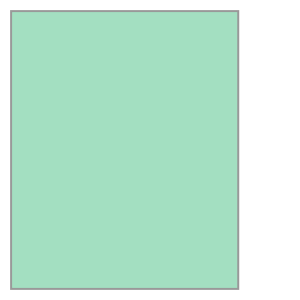

In [108]:
# Get the bounding box coordinates
minx, miny, maxx, maxy = gent.bounds

from shapely import Polygon

# Create a Polygon from the bounding box coordinates
gent_region = Polygon([(minx, miny), (minx, maxy), (maxx, maxy), (maxx, miny)])

gent_region

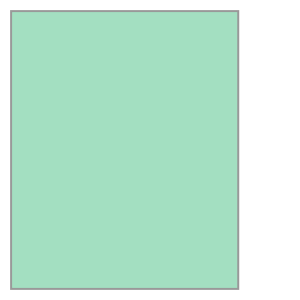

In [109]:
# Alternatives:
# Same as the method above
gent.envelope

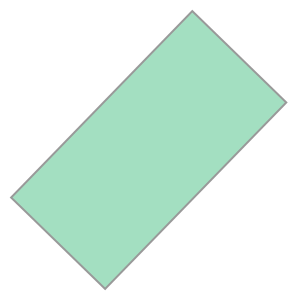

In [110]:
# Smallest rectangle that contains the data
gent.minimum_rotated_rectangle

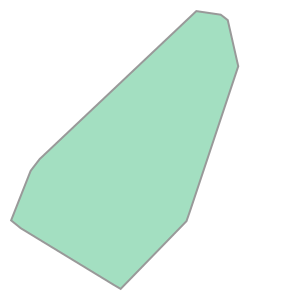

In [111]:
gent.convex_hull

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality47.py

<div class="alert alert-success">

**EXERCISE 22**:

* Using the `gent_region` shape, create a subset the measurements dataframe with those measurements located within Gent. Call the result `gdf_gent`.
* How many measurements are left in the subset?
    
<details><summary>Hints</summary>

* Ensure to use `gdf_lambert` and not `gdf`, since the `gent` shape is extracted from the `muni` dataframe with EPSG:31370 CRS.
* To check for a series of points whether they are located in a given polygon, use the `within()` method.
* Use the resulting boolean Series to mask the original `gdf` GeoDataFrame using boolean indexing (`[]` notation).
    
</details>

</div>

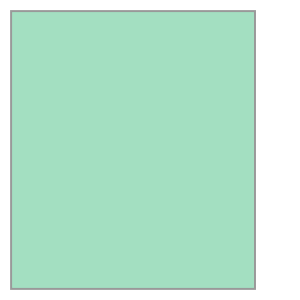

In [138]:
# Crs not correct
gent = muni[muni['NAAM'] == "Gent"].to_crs('EPSG:3035').geometry.item()

gent_region = gent.envelope

gent_region

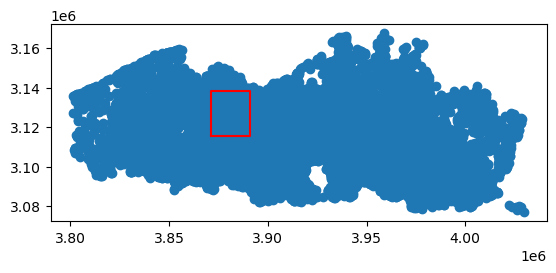

In [140]:
# Correct CRS now
gdf_raster.plot()
x, y = gent_region.exterior.xy
plt.plot(x, y, c = 'r')

In [144]:
# Select all rows within the gent region
gdf_gent = gdf_raster[gdf_raster.within(gent_region)]

len(gdf_gent)

1289

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality48.py
gdf_gent = gdf_lambert[gdf_lambert.within(gent_region)].copy()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality49.py
len(gdf_gent)

Alternatively, we can also use the `geopandas.clip()` function. For points there is not much difference with the method above, but for lines or polygons, it will actually "clip" the geometries, i.e. removing the parts that fall outside of the specified region (in addition, this method also uses a spatial index under the hood and will typically be faster for large datasets):

In [ ]:
gdf_gent = geopandas.clip(gdf_lambert, gent_region).copy()
len(gdf_gent)

<div class="alert alert-success">

**EXERCISE 23**:

* Make a visualization of the measurements in Gent. Use contextily to add a background basemap. Color the points based on the NO2 concentration.


<details><summary>Hints</summary>

* For using one of the columns of the GeoDataFrame to determine the fill color, use the `column=` keyword.
* To add a background map, use the `contextily.add_basemap()` function. It takes the matplotlib `ax` to which to add a map as the first argument.
* Remember that, to use a contextily background, the data needs to be in Web Mercator ("EPSG:3857").

</details>

</div>

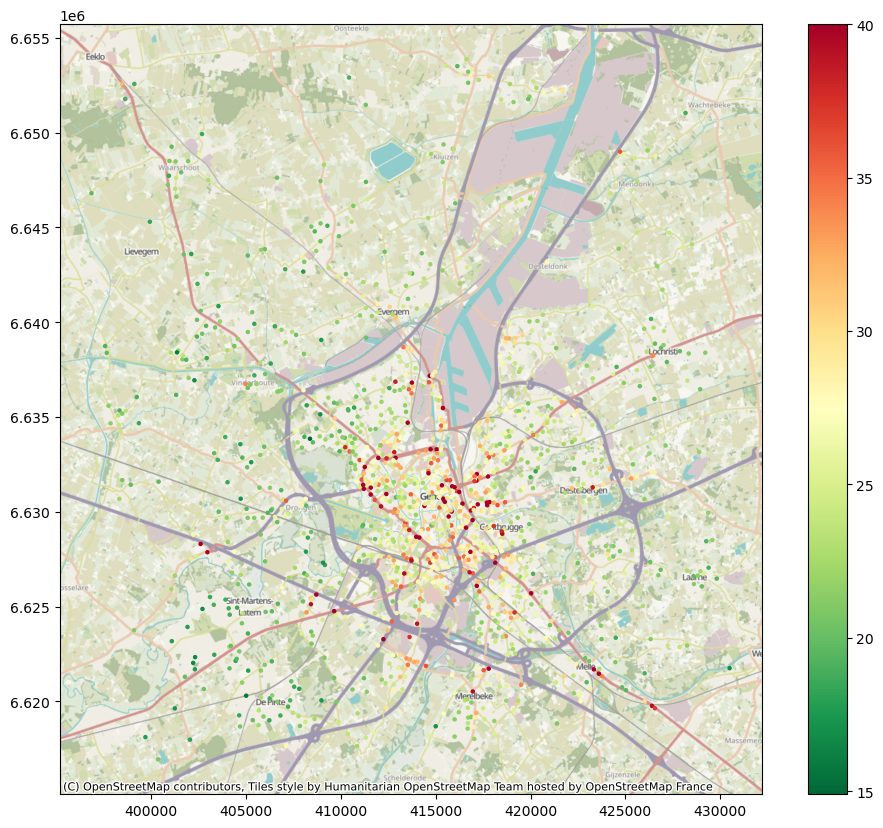

In [160]:
f, ax = plt.subplots(figsize = (12,10))

gdf_gent.to_crs("EPSG:3857").plot(column = 'no2', cmap = "RdYlGn_r", vmax = 40, ax = ax, legend = True, markersize = 5)

cx.add_basemap(ax = ax)

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality50.py
import contextily

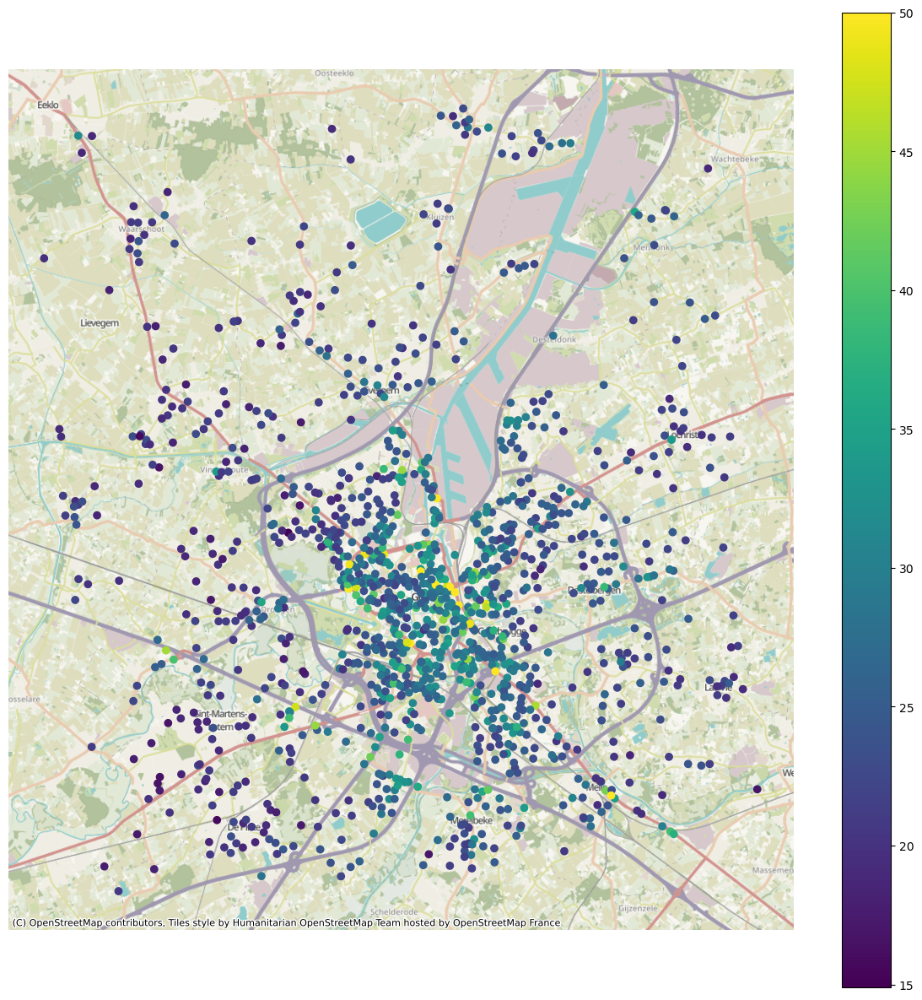

In [152]:
# %load _solutions/case-curieuzeneuzen-air-quality51.py
fig, ax = plt.subplots(figsize=(15, 15))
ax = gdf_gent.to_crs(3857).plot(column="no2", ax=ax, legend=True, vmax=50)
cx.add_basemap(ax)
ax.set_axis_off()

The solution above includes a `vmax=50` to indicate to use a max value of 50 for the colorbar range (there are few measurements with much higher values, that would otherwise make most other points look dark blue-ish). A better option can be to use one of the classification schemes from `mapclassify` through the `scheme` keyword.

Further zooming in on the city center, using a discrete color scheme and a different tile provider (not asked in exercise, but uncomment and run to see):

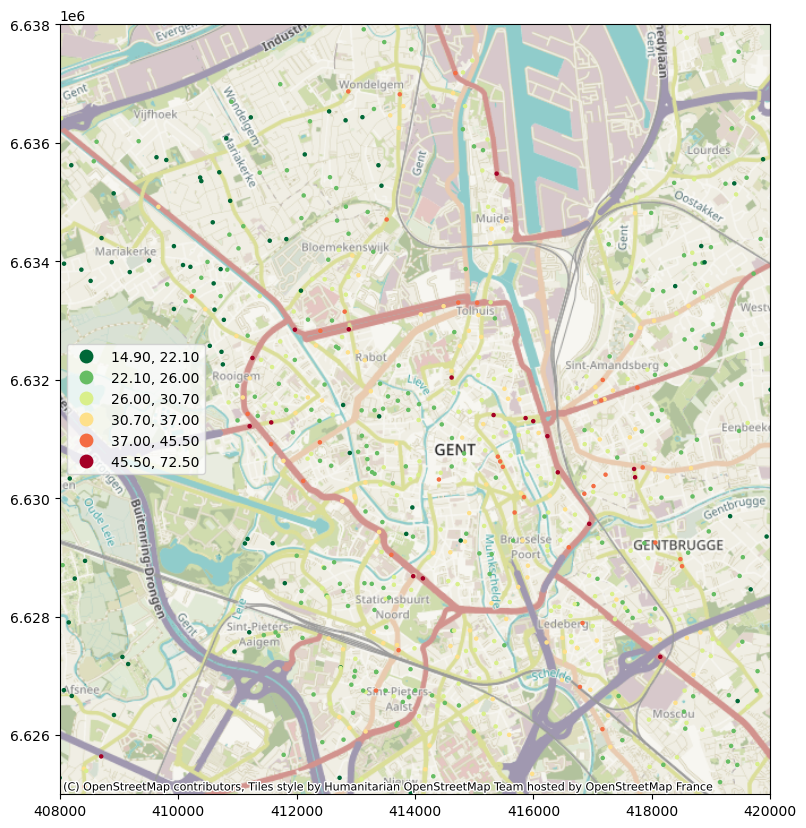

In [164]:
f, ax = plt.subplots(figsize = (12,10))

gdf_gent.to_crs("EPSG:3857").plot(
    column = 'no2', 
    scheme = "NaturalBreaks", 
    k = 6,
    ax = ax, 
    legend = True, 
    markersize = 5,
    cmap = "RdYlGn_r"
)

ax.set(xlim=(408_000, 420_000), ylim=(6_625_000, 6_638_000))

cx.add_basemap(ax = ax)

UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x0000020308141DA0>

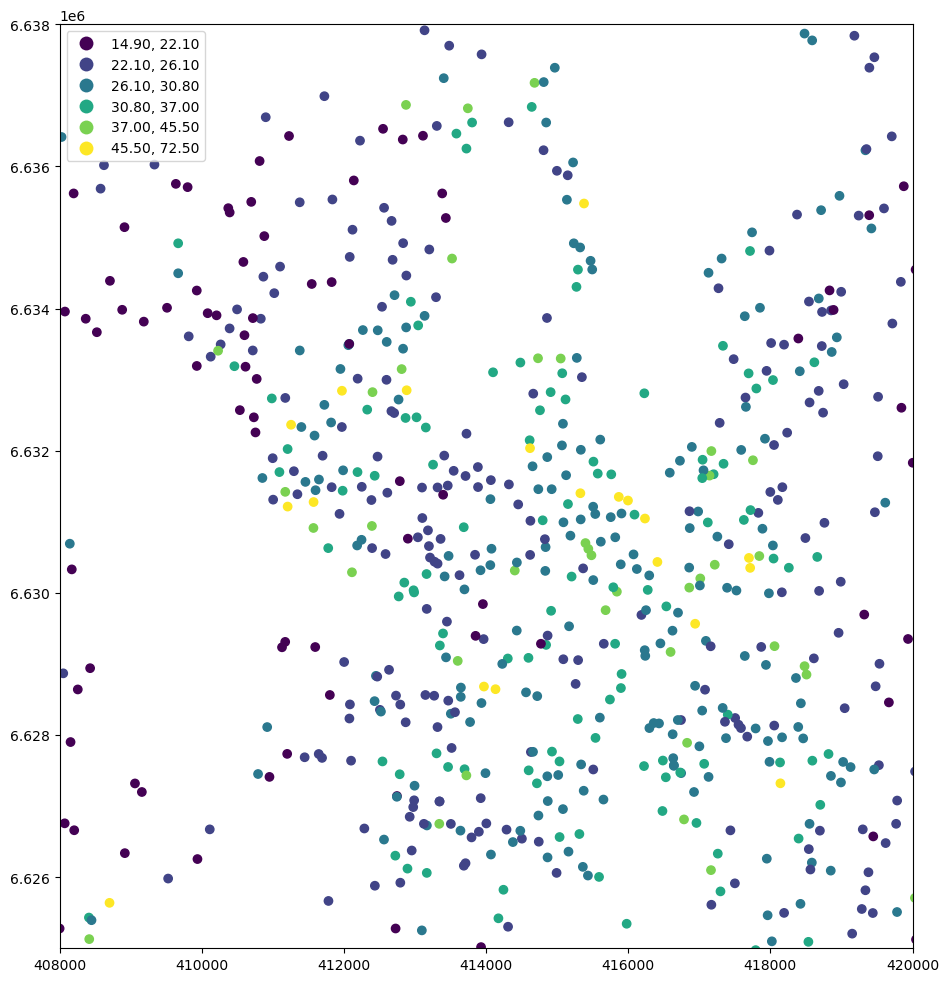

In [167]:
# %load _solutions/case-curieuzeneuzen-air-quality52.py
fig, ax = plt.subplots(figsize=(12, 12))
ax = gdf_gent.to_crs(3857).plot(column="no2", ax=ax, scheme="NaturalBreaks", k=6, legend=True)
ax.set(xlim=(408_000, 420_000), ylim=(6_625_000, 6_638_000))
# Unfortunately, Stamen sold out so we can't use their shit anymore
# cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite)
ax.set_axis_off()

## Combining with OpenStreetMap information

We downloaded and filtered OpenStreetMap data for the area of Gent, focusing on the street network information, and provided this as a GeoPackage file (`data/osm_network_gent.gpkg`, see this [notebook](./data/preprocess_data.ipynb#OpenStreetMap) to check the code to download and preprocess the raw OSM data).

The OpenStreetMap street network data includes information about the type of street in the "highway" tag. We can use this as a proxy for traffic intensity of the street, and relate that to the measured NO2 concentration.

<div class="alert alert-success">

**EXERCISE 24**:

* Read the `"data/osm_network_gent.gpkg"` file into a `streets` variable, and check the first rows.
* Convert the data to the appropriate CRS to combine with the `gdf_gent` data, if needed.
* Make a quick plot to explore the data.
    
</div>

In [168]:
streets = geopandas.read_file("data/osm_network_gent.gpkg")

streets = streets.to_crs(gdf_gent.crs)

streets

,highway,name,osm_type,geometry
0,primary,Oudenaardsesteenweg,way,"LINESTRING (3880217.432 3119768.253, 3880218.9..."
1,primary,Krijgslaan,way,"LINESTRING (3880437.057 3120639.603, 3880442.7..."
2,residential,Paul Fredericqstraat,way,"LINESTRING (3880696.681 3122166.753, 3880695.2..."
3,residential,Meersstraat,way,"LINESTRING (3880470.491 3122027.430, 3880474.0..."
4,residential,Jakob Heremansstraat,way,"LINESTRING (3880580.539 3122338.648, 3880576.4..."
...,...,...,...,...
27198,pedestrian,Pieter Vanderdoncktdoorgang,way,"LINESTRING (3882058.201 3123015.850, 3882039.4..."
27199,residential,Schepenenvijverstraat,way,"LINESTRING (3882058.201 3123015.850, 3882034.4..."
27200,residential,Spoorwegstraat,way,"LINESTRING (3880642.272 3129376.318, 3880598.8..."
27201,service,NaN,way,"LINESTRING (3879100.226 3129717.959, 3879099.5..."


In [169]:
streets.explore()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality53.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality54.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality55.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality56.py

(Note: for interactively exploring such data, there are better solutions as the GeoPandas `.plot()` method, such as opening the data in QGIS, or using an interactive visualization library, see notebook [visualization-04-interactive](./visualization-04-interactive.ipynb)).

To relate the measured concentration with the road type, we want to determine for each location at what type of street it is located. Since the measurements are not exactly located on one of the lines, we are going to look at the closest street for each location.

<div class="alert alert-success">

**EXERCISE 25**:

* Calculate the distance between the point (defined below) and all streets. And what is the minimum distance?
* Use the `idxmin()` method to know get the label of which row contains the minimum distance.
* Using the result of `idxmin()`, we can get the row or the value in the "highway" column that corresponds to the street that is closest to `point`.

<details><summary>Hints</summary>

* The distance method of a Shapely geometry does not accept a GeoSeries of geometries, only a single other geometry (so `point.distance(series)` does not work). However, the distance method is commutative, so you can always switch the order to use the distance method of the GeoSeries (`series.distance(point)` does work).
* Given a row label, you can get the value of a Series/column with `s[label]`, or the row of a DataFrame with `df.loc[label]`. With both row label and column name, you can get the corresponding value of a DataFrame with `df.loc[label, column_name]`.
</details>

</div>

We take the first point geometry in the Gent dataset:

In [172]:
point = gdf_gent["geometry"].iloc[0]

In [175]:
# idxmin finds the index of the minimum distance
streets.distance(point).idxmin()

5831

In [176]:
streets.iloc[streets.distance(point).idxmin()]

highway                                           residential
name                                   Kleine Goedingenstraat
osm_type                                                  way
geometry    LINESTRING (3877305.5474476293 3121391.2488300...
Name: 5831, dtype: object

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality57.py
streets.distance(point)

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality58.py
streets.distance(point).min()

In [184]:
# %load _solutions/case-curieuzeneuzen-air-quality59.py
idx_closest = streets.distance(point).idxmin()
idx_closest

5831

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality60.py
streets.loc[idx_closest]

In [185]:
# %load _solutions/case-curieuzeneuzen-air-quality61.py
streets["highway"][idx_closest]

'residential'

In [186]:
# %load _solutions/case-curieuzeneuzen-air-quality62.py
streets.loc[idx_closest, "highway"]

'residential'

We now want to repeat the above analysis for each measurement location. So let's start with writing a reusable function.

<div class="alert alert-success">

**EXERCISE 26**:

* Define a function `closest_road_type` that accepts a single point and the streets dataframe, and returns the class of the closest street.
* Check that the function works by using it on the `point` defined above.

As help, you can start from this skeleton:
    
```python
def closest_road_type(point, streets):
    # determine "highway" tag of the closest street
    idx_closest = ...
    ...
    return ... 
```

</div>

In [193]:
def closest_road_type(point, streets):
    """
    Returns road class of the closest street to the given point
    """
    idx_closest = streets.distance(point).idxmin()
    return streets.iloc[idx_closest]['highway']

In [195]:
closest_road_type(point, streets)

'residential'

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality63.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality64.py

Now we can apply this function to each of the point locations. However, with this brute force method, applying it as is using `gdf_gent` and `streets` takes quite some time. We can speed up the distance calculation by reducing the number of linestrings in the `streets` dataframe to compare with.

<div class="alert alert-success">

**EXERCISE 27**:

* Create a `streets_unioned` dataframe with a single line per road type (a union of all lines per road type). Check the `dissolve()` method for this.
* Repeat the `apply` call, but now on all points and using `streets_unioned` instead of `streets`.
* Assign the result of the apply to a new columns "road_type".
* Do a value counts of this new column.
    
</div>

When running this, you can see it already takes a bit of time, even for the first 20 rows:

In [196]:
%time gdf_gent.geometry.head(20).apply(lambda point: closest_road_type(point, streets))

# 300ms for the first 20 rows

CPU times: total: 344 ms
Wall time: 352 ms


22       residential
35       residential
46         secondary
53       residential
54          tertiary
55       residential
61       residential
62       residential
65          tertiary
67       residential
75       residential
87       residential
92          tertiary
95       residential
110      residential
152         tertiary
165      residential
180          primary
187    living_street
225      residential
dtype: object

In [202]:
# Dissolve the streets dataset by highway type
streets_unioned = streets.dissolve(by = "highway").reset_index()

streets_unioned

,highway,geometry,name,osm_type
0,bridleway,"MULTILINESTRING ((3876420.089 3129417.203, 387...",Rabotwegel,way
1,construction,"MULTILINESTRING ((3882395.241 3125613.909, 388...",Koopvaardijlaan,way
2,corridor,"MULTILINESTRING ((3882724.941 3123783.378, 388...",None,way
3,cycleway,"MULTILINESTRING ((3884447.922 3122911.637, 388...",Nijverheidskaai,way
4,footway,"MULTILINESTRING ((3880501.016 3121771.183, 388...",Estafetteweg,way
5,living_street,"MULTILINESTRING ((3881035.775 3123133.224, 388...",Pekelharing,way
6,path,"MULTILINESTRING ((3879450.519 3122690.527, 387...",Griendijk,way
7,pedestrian,"MULTILINESTRING ((3881217.966 3122829.333, 388...",Lindenlei,way
8,primary,"MULTILINESTRING ((3880217.432 3119768.253, 388...",Oudenaardsesteenweg,way
9,primary_link,"MULTILINESTRING ((3881021.368 3122393.061, 388...",Brusselsesteenweg,way


In [205]:
gdf_gent['road_type'] = gdf_gent.geometry.apply(lambda x: closest_road_type(x, streets_unioned))

gdf_gent

C:\Users\tranq\anaconda3\envs\gdal\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,code,campaign,no2,lat,lon,geometry,index_right,OIDN,UIDN,VERSDATUM,...,DATPUBLBS,NUMAC,NISCODE,NAAM,LENGTE,OPPERVL,exceedence,land_use,land_use_class,road_type
22,193077,facade,19.1,51.030880,3.665770,POINT (3877280.177 3121411.936),116,38.0,38.0,1900-01-01,...,1982-12-29,1982001920,44021,Gent,98170.877375,1.577187e+08,False,2,Discontinuous urban fabric,residential
35,193479,facade,28.6,51.058930,3.700956,POINT (3880005.161 3124309.757),116,38.0,38.0,1900-01-01,...,1982-12-29,1982001920,44021,Gent,98170.877375,1.577187e+08,False,2,Discontinuous urban fabric,residential
46,193677,facade,43.1,51.027160,3.747452,POINT (3882950.737 3120506.722),116,38.0,38.0,1900-01-01,...,1982-12-29,1982001920,44021,Gent,98170.877375,1.577187e+08,True,2,Discontinuous urban fabric,secondary
53,193797,facade,31.6,51.019160,3.763333,POINT (3883984.783 3119524.404),116,38.0,38.0,1900-01-01,...,1982-12-29,1982001920,44021,Gent,98170.877375,1.577187e+08,False,2,Discontinuous urban fabric,residential
54,193836,facade,30.1,51.070070,3.703455,POINT (3880285.713 3125530.128),116,38.0,38.0,1900-01-01,...,1982-12-29,1982001920,44021,Gent,98170.877375,1.577187e+08,False,2,Discontinuous urban fabric,tertiary
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14471,322383,facade,18.9,51.018560,3.630419,POINT (3874692.359 3120260.898),175,202.0,202.0,1900-01-01,...,1976-01-23,1975123003,44064,Sint-Martens-Latem,19982.915763,1.443683e+07,False,2,Discontinuous urban fabric,residential
15612,331842,facade,20.3,50.996406,3.618163,POINT (3873622.407 3117879.132),175,202.0,202.0,1900-01-01,...,1976-01-23,1975123003,44064,Sint-Martens-Latem,19982.915763,1.443683e+07,False,18,Agricultural areas,residential
15653,332142,facade,20.3,51.019390,3.647431,POINT (3875888.864 3120249.214),175,202.0,202.0,1900-01-01,...,1976-01-23,1975123003,44064,Sint-Martens-Latem,19982.915763,1.443683e+07,False,2,Discontinuous urban fabric,residential
16399,338727,facade,19.6,51.005410,3.633706,POINT (3874795.444 3118782.580),175,202.0,202.0,1900-01-01,...,1976-01-23,1975123003,44064,Sint-Martens-Latem,19982.915763,1.443683e+07,False,21,Agricultural areas,service


In [206]:
gdf_gent['road_type'].value_counts()

road_type
residential      879
tertiary         204
secondary         60
primary           49
unclassified      49
living_street     22
track              8
service            7
pedestrian         3
footway            3
cycleway           3
path               2
Name: count, dtype: int64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality65.py
streets_unioned = streets.dissolve("highway").reset_index()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality66.py
gdf_gent["road_type"] = gdf_gent.geometry.apply(lambda point: closest_road_type(point, streets_unioned))

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality67.py
gdf_gent.head()

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality68.py
gdf_gent["road_type"].value_counts()

**Note!** We have been using a brute-force search for the closest street by calculating for each point the distance to all streets. This is a good exercise to learn the syntax, but there are however better methods for such "nearest" queries. See eg https://automating-gis-processes.github.io/site/notebooks/L3/nearest-neighbor-faster.html

<div class="alert alert-success">

**EXERCISE 28**:

There are some uncommon categories. For the remainder of this demo, let's group some related categories, and filter out some others.
    
* Using the defined mapping, replace some values with "pedestrian" in the `"road_type"` column.
* Using the defined subset of categories, create a subset of `gdf_gent` where the road type "is in" this subset of categories (look at the pandas `isin()` ([doc link](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.isin.html)) method). Call the result `subset`, and do again a value counts to check the result.
    
<details><summary>Hints</summary>

* The `replace()` method can be called on a column. Pass a dictionary to this method, and the keys of the dictionary present in the column will be replaces with the corresponding values defined in the dictionary.
* The `Series.isin()` method accepts a list of values, and will return a boolean Series indicating for each element of the original Series whether it is present in the list of values or not. 
* The boolean Series can then be used to filter the original `gdf_gent` dataframe using boolean indexing.
</details>

</div>

Replace categories:

In [207]:
mapping = {
    "footway": "pedestrian",
    "living_street": "pedestrian",
    "path": "pedestrian",
}

In [221]:
gdf_gent[gdf_gent['road_type'].isin(mapping.keys())]['road_type'].value_counts()

road_type
living_street    22
footway           3
path              2
Name: count, dtype: int64

In [218]:
gdf_gent['road_type'].replace(mapping)

22       residential
35       residential
46         secondary
53       residential
54          tertiary
            ...     
14471    residential
15612    residential
15653    residential
16399        service
17689    residential
Name: road_type, Length: 1289, dtype: object

In [217]:
gdf_gent['road_type'].value_counts()

road_type
residential      879
tertiary         204
secondary         60
primary           49
unclassified      49
living_street     22
track              8
service            7
pedestrian         3
footway            3
cycleway           3
path               2
Name: count, dtype: int64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality69.py
gdf_gent["road_type"] = gdf_gent["road_type"].replace(mapping)

Filter categories:

In [224]:
gdf_gent["road_type"] = gdf_gent['road_type'].replace(mapping)

C:\Users\tranq\anaconda3\envs\gdal\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [225]:
categories = ["primary", "secondary", "tertiary", "residential", "pedestrian"]

In [226]:
gdf_gent["road_type"].value_counts()

road_type
residential     879
tertiary        204
secondary        60
primary          49
unclassified     49
pedestrian       30
track             8
service           7
cycleway          3
Name: count, dtype: int64

In [229]:
# %load _solutions/case-curieuzeneuzen-air-quality70.py
subset = gdf_gent[gdf_gent["road_type"].isin(categories)]

subset["road_type"].value_counts()

road_type
residential    879
tertiary       204
secondary       60
primary         49
pedestrian      30
Name: count, dtype: int64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality71.py
subset.groupby("road_type").size()  # subset["road_type"].value_counts()

<div class="alert alert-success">

**EXERCISE 29**:

* Calculate the average measured concentration depending on the type of the road next to the measurement location.

</div>

In [233]:
gdf_gent.groupby('road_type')['no2'].mean().sort_values(ascending = False)

road_type
primary         37.522449
secondary       30.325000
tertiary        28.580392
pedestrian      25.230000
residential     24.774403
service         23.528571
unclassified    21.963265
track           20.650000
cycleway        20.533333
Name: no2, dtype: float64

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality72.py
subset.groupby("road_type")['no2'].mean()

<div class="alert alert-success">

**EXERCISE 30**:

* Similarly, make a plot with `seaborn` of those results. Specify the `categories` as the order to use for the plot.

</div>

<Axes: xlabel='no2', ylabel='road_type'>

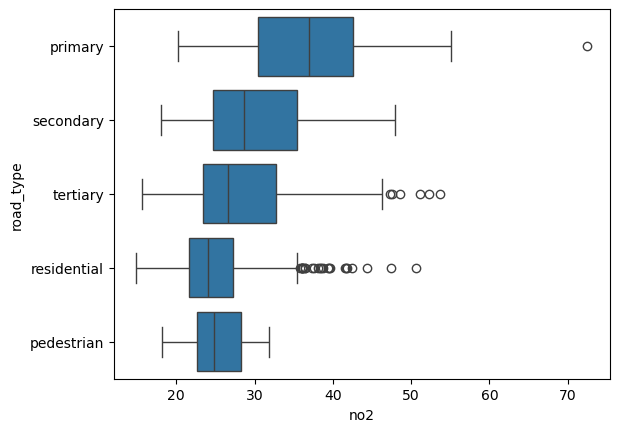

In [236]:
sns.boxplot(subset, x = 'no2', y = 'road_type', order = categories)

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality73.py

In [ ]:
# %load _solutions/case-curieuzeneuzen-air-quality74.py

This analysis confirms that the NO2 concentration is clearly related to traffic.